In [7]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import norm
import random
from collections import Counter, defaultdict
from matplotlib import rc
rc('animation', html='jshtml')

In [8]:
class AgingOrganism:
    """
    Simulator of the growth and aging process of a living organism, based on
    a quantum-topological approach using symbolic sequences.
    """

    def __init__(self, genome_length=100, lifespan=100, repair_efficiency=0.8):
        """
        Initialization of the organism model.

        Args:
            genome_length: Length of the organism's genome
            lifespan: Expected lifespan (in conditional time units)
            repair_efficiency: Initial efficiency of repair mechanisms (0-1)
        """
        # Basic parameters
        self.genome_length = genome_length
        self.max_lifespan = lifespan
        self.current_age = 0
        self.is_alive = True
        self.repair_efficiency = repair_efficiency

        # Create a dictionary of opposite elements (for homotopic operations)
        self.alphabet = {'A': 'a', 'C': 'c', 'G': 'g', 'T': 't',
                         'a': 'A', 'c': 'C', 'g': 'G', 't': 'T'}

        # Biological indicators
        self.vitality = 1.0  # Vitality (1.0 = maximum)
        self.damage_rate = 0.01  # Base rate of damage accumulation
        self.metabolism_rate = 1.0  # Metabolism rate
        self.growth_phase = True  # Whether the organism is in growth phase
        self.growth_complete_age = int(self.max_lifespan * 0.2)  # Age of growth completion
        self.decay_start_age = int(self.max_lifespan * 0.7)  # Age of accelerated aging onset

        # Create the initial genome
        self.genome = self._generate_initial_genome()
        self.original_genome = self.genome.copy()  # Save a copy of the original genome

        # Histones and epigenetic marks
        self.histone_marks = np.ones(genome_length, dtype=float)  # 1 = open chromatin

        # Organism systems and their state
        self.systems = {
            'cardiovascular': 1.0,
            'immune': 1.0,
            'nervous': 1.0,
            'endocrine': 1.0,
            'muscular': 1.0,
            'skeletal': 1.0,
            'digestive': 1.0,
            'respiratory': 1.0
        }

        # Functional genes and their association with systems
        self.genes = self._map_genes_to_systems()

        # Tracking state over time
        self.age_history = [0]
        self.vitality_history = [self.vitality]
        self.damage_history = [0]
        self.repair_history = [self.repair_efficiency]
        self.systems_history = {system: [value] for system, value in self.systems.items()}
        self.metabolism_history = [self.metabolism_rate]
        self.genome_entropy_history = [self._calculate_genome_entropy()]
        self.telomere_length_history = [1.0]  # Normalized telomere length

        # Quantum aspects of the model
        self.quantum_state = np.array([1.0, 0.0], dtype=complex)  # Initial quantum state |healthy⟩
        self.quantum_state_history = [self.quantum_state.copy()]

        # Telomeres
        self.telomere_length = 1.0  # Normalized length from 0 to 1
        self.telomere_shortening_rate = 0.005  # Base rate of telomere shortening

        print(f"Organism initialized with genome length {genome_length}, expected lifespan {lifespan}")

    def _generate_initial_genome(self):
        """
        Generates the initial genome of the organism.

        Returns:
            List of symbols representing the genome
        """
        # Generate a random DNA sequence
        # Use only uppercase letters for original genes (without damage)
        nucleotides = ['A', 'C', 'G', 'T']
        genome = [random.choice(nucleotides) for _ in range(self.genome_length)]
        return genome

    def _map_genes_to_systems(self):
        """
        Maps genes to organism systems.

        Returns:
            Dictionary of gene associations with systems
        """
        genes = {}
        systems_list = list(self.systems.keys())

        # Distribute genes across systems (each gene can affect multiple systems)
        for i in range(self.genome_length):
            genes[i] = {
                'systems': random.sample(systems_list, random.randint(1, 3)),
                'importance': random.uniform(0.01, 0.1)  # Importance of the gene for systems
            }
        return genes

    def _calculate_genome_entropy(self):
        """
        Calculates genome entropy as a measure of its orderliness.

        Returns:
            Genome entropy value
        """
        # Count the frequencies of symbols
        frequencies = Counter(self.genome)
        total = len(self.genome)

        # Calculate Shannon entropy
        entropy = 0
        for count in frequencies.values():
            probability = count / total
            entropy -= probability * np.log2(probability)

        return entropy

    def _calculate_genome_damage(self):
        """
        Calculates the degree of genome damage compared to the original.

        Returns:
            Proportion of damaged genes
        """
        damages = sum(1 for i in range(len(self.genome))
                    if self.genome[i] != self.original_genome[i])
        return damages / self.genome_length

    def _homotopy_reduction(self, sequence):
        """
        Performs a homotopic reduction of a sequence,
        removing pairs of opposite elements.

        Args:
            sequence: Symbolic sequence

        Returns:
            Homotopically reduced sequence
        """
        stack = []
        for symbol in sequence:
            if stack and symbol == self.alphabet.get(stack[-1], None):
                # Remove a pair of opposite elements
                stack.pop()
            else:
                stack.append(symbol)
        return stack

    def _update_quantum_state(self):
        """
        Updates the quantum state of the organism based on its current state.
        """
        # Determine the rotation angle of the Bloch vector based on vitality
        theta = np.arccos(self.vitality) * 2  # Transform vitality [0,1] to angle [0,π]

        # Update quantum state (|healthy⟩ -> |old⟩)
        self.quantum_state = np.array([np.cos(theta/2), np.sin(theta/2)], dtype=complex)
        self.quantum_state_history.append(self.quantum_state.copy())

    def _apply_damage(self):
        """
        Applies random damage to the genome.
        """
        # Base amount of damage depends on age and metabolism
        if self.growth_phase:
            # During growth, there is less damage
            base_damage_count = int(np.ceil(self.genome_length * self.damage_rate * 0.5 * self.metabolism_rate))
        else:
            # After growth phase, there is more damage
            age_factor = 1 + max(0, (self.current_age - self.decay_start_age) / (self.max_lifespan - self.decay_start_age))
            base_damage_count = int(np.ceil(self.genome_length * self.damage_rate * age_factor * self.metabolism_rate))

        # Select random positions for damage
        damage_positions = random.sample(range(self.genome_length),
                                       min(base_damage_count, self.genome_length))

        # Apply damage (replace uppercase letters with lowercase)
        for pos in damage_positions:
            if self.genome[pos].isupper():  # If the gene is not yet damaged
                # With repair_efficiency probability, restore the gene
                if random.random() > self.repair_efficiency:
                    # Apply damage
                    self.genome[pos] = self.genome[pos].lower()

                    # Update histone marks (damage affects epigenetics)
                    self.histone_marks[pos] = max(0.1, self.histone_marks[pos] - random.uniform(0.05, 0.2))

    def _repair_damage(self):
        """
        Repairs part of the genome damage.
        """
        # Base number of repairs
        repair_count = int(self.genome_length * self.damage_rate * self.repair_efficiency * 0.8)

        # Find damaged genes
        damaged_positions = [i for i in range(self.genome_length)
                           if self.genome[i].islower()]

        if damaged_positions:
            # Select random positions for repair
            repair_positions = random.sample(damaged_positions,
                                          min(repair_count, len(damaged_positions)))

            # Repair genes
            for pos in repair_positions:
                self.genome[pos] = self.genome[pos].upper()

                # Update histone marks
                self.histone_marks[pos] = min(1.0, self.histone_marks[pos] + random.uniform(0.02, 0.1))

    def _update_systems(self):
        """
        Updates the state of the organism's systems based on the current state of the genome.
        """
        for system in self.systems:
            # Base regenerative potential, decreases with age
            regeneration = 0.01 * max(0, 1 - self.current_age / self.max_lifespan)

            # Sum of damages affecting the system
            damage_impact = 0
            genes_affecting_system = 0

            for gene_idx, gene_info in self.genes.items():
                if system in gene_info['systems']:
                    genes_affecting_system += 1
                    # If the gene is damaged, account for its impact
                    if self.genome[gene_idx].islower():
                        damage_impact += gene_info['importance']

            # Normalize damage impact
            if genes_affecting_system > 0:
                normalized_impact = damage_impact / genes_affecting_system
            else:
                normalized_impact = 0

            # Update system state
            self.systems[system] = max(0.01, min(1.0,
                                            self.systems[system] - normalized_impact + regeneration))

            # Save history
            self.systems_history[system].append(self.systems[system])

    def _update_repair_efficiency(self):
        """
        Updates the efficiency of repair mechanisms with age.
        """
        # Base decline in efficiency with age
        base_decline = 0.002 * (1 + max(0, (self.current_age - self.decay_start_age) /
                                        (self.max_lifespan - self.decay_start_age)))

        # Endocrine system state affects regeneration
        endocrine_factor = self.systems['endocrine']

        # Update repair efficiency
        self.repair_efficiency = max(0.05, min(0.95,
                                            self.repair_efficiency - base_decline * (2 - endocrine_factor)))

        # Save history
        self.repair_history.append(self.repair_efficiency)

    def _update_metabolism(self):
        """
        Updates metabolism rate with age.
        """
        if self.growth_phase:
            # During growth, metabolism is higher
            target_metabolism = 1.2
        else:
            # After growth, metabolism gradually decreases
            age_factor = self.current_age / self.max_lifespan
            target_metabolism = 1.0 - 0.4 * age_factor

        # Smooth change to target value
        self.metabolism_rate += (target_metabolism - self.metabolism_rate) * 0.1

        # Impact of endocrine and cardiovascular systems
        endocrine_impact = (self.systems['endocrine'] - 0.5) * 0.2
        cardiovascular_impact = (self.systems['cardiovascular'] - 0.5) * 0.2

        self.metabolism_rate += endocrine_impact + cardiovascular_impact
        self.metabolism_rate = max(0.3, min(1.5, self.metabolism_rate))

        # Save history
        self.metabolism_history.append(self.metabolism_rate)

    def _update_telomeres(self):
        """
        Updates telomere length with age.
        """
        # Base telomere shortening
        base_shortening = self.telomere_shortening_rate * self.metabolism_rate

        # High metabolism accelerates telomere shortening
        metabolism_factor = 1 + max(0, self.metabolism_rate - 1.0) * 2

        # Update telomere length
        self.telomere_length = max(0.01, self.telomere_length - base_shortening * metabolism_factor)

        # When telomeres are short, it accelerates aging
        if self.telomere_length < 0.3:
            telomere_effect = (0.3 - self.telomere_length) * 3
            self.damage_rate = min(0.05, self.damage_rate + telomere_effect * 0.001)

        # Save history
        self.telomere_length_history.append(self.telomere_length)

    def _update_vitality(self):
        """
        Updates the overall vitality of the organism.
        """
        # Weighted average state of all systems
        systems_avg = sum(self.systems.values()) / len(self.systems)

        # Telomere length impact
        telomere_impact = self.telomere_length

        # Genome factor
        genome_damage = self._calculate_genome_damage()
        genome_factor = 1 - genome_damage

        # Calculate final vitality
        self.vitality = 0.4 * systems_avg + 0.3 * telomere_impact + 0.3 * genome_factor

        # Reduce vitality with age after reaching decay_start_age
        if self.current_age > self.decay_start_age:
            age_impact = (self.current_age - self.decay_start_age) / (self.max_lifespan - self.decay_start_age)
            self.vitality *= (1 - 0.3 * age_impact)

        # Limit within [0, 1]
        self.vitality = max(0, min(1, self.vitality))

        # Save history
        self.vitality_history.append(self.vitality)

        # Death if vitality falls below critical level
        if self.vitality < 0.05:
            self.is_alive = False
            print(f"Organism died at age {self.current_age}")

    def age(self):
        """
        Simulates one step of organism aging.

        Returns:
            Organism life flag (True - alive, False - dead)
        """
        if not self.is_alive:
            return False

        # Increase age
        self.current_age += 1
        self.age_history.append(self.current_age)

        # Update growth phase
        if self.current_age >= self.growth_complete_age:
            self.growth_phase = False

        # Apply aging
        self._apply_damage()
        self._repair_damage()
        self._update_systems()
        self._update_repair_efficiency()
        self._update_metabolism()
        self._update_telomeres()
        self._update_vitality()

        # Calculate and save genome entropy
        self.genome_entropy_history.append(self._calculate_genome_entropy())

        # Save genome damage
        self.damage_history.append(self._calculate_genome_damage())

        # Update quantum state
        self._update_quantum_state()

        # Natural death from old age
        if self.current_age >= self.max_lifespan:
            chance_of_death = (self.current_age - self.max_lifespan + 10) / 10
            if random.random() < chance_of_death:
                self.is_alive = False
                print(f"Organism died of old age at {self.current_age}")

        return self.is_alive

    def visualize_aging_process(self, show_systems=True):
        """
        Visualizes the organism's aging process.

        Args:
            show_systems: Flag to display organism system graphs
        """
        # Create a figure for visualization
        if show_systems:
            fig = plt.figure(figsize=(20, 15))
            gs = fig.add_gridspec(3, 3)
        else:
            fig = plt.figure(figsize=(18, 10))
            gs = fig.add_gridspec(2, 2)

        # Vitality graph
        ax1 = fig.add_subplot(gs[0, 0])
        ax1.plot(self.age_history, self.vitality_history, 'g-', linewidth=2, label='Vitality')
        ax1.set_xlabel('Age')
        ax1.set_ylabel('Vitality')
        ax1.set_title('Change in Vitality with Age')
        ax1.grid(True)
        ax1.legend()

        # Genome damage graph
        ax2 = fig.add_subplot(gs[0, 1])
        ax2.plot(self.age_history, self.damage_history, 'r-', linewidth=2, label='Damage')
        ax2.plot(self.age_history, self.repair_history, 'b-', linewidth=2, label='Repair Efficiency')
        ax2.set_xlabel('Age')
        ax2.set_ylabel('Level')
        ax2.set_title('Genome Damage and Repair Efficiency')
        ax2.grid(True)
        ax2.legend()

        # Genome entropy graph and telomere length
        ax3 = fig.add_subplot(gs[1, 0])
        ax3.plot(self.age_history, self.genome_entropy_history, 'purple', linewidth=2, label='Genome Entropy')
        ax3.set_xlabel('Age')
        ax3.set_ylabel('Entropy')
        ax3.set_title('Change in Genome Entropy with Age')
        ax3.grid(True)
        ax3.legend()

        # Telomere length and metabolism graph
        ax4 = fig.add_subplot(gs[1, 1])
        ax4.plot(self.age_history, self.telomere_length_history, 'c-', linewidth=2, label='Telomere Length')
        ax4.plot(self.age_history, self.metabolism_history, 'm-', linewidth=2, label='Metabolism Rate')
        ax4.set_xlabel('Age')
        ax4.set_ylabel('Value')
        ax4.set_title('Telomere Length and Metabolism Rate')
        ax4.grid(True)
        ax4.legend()

        if show_systems:
            # Organism systems graph
            ax5 = fig.add_subplot(gs[2, :])
            for system, history in self.systems_history.items():
                ax5.plot(self.age_history, history, label=system)
            ax5.set_xlabel('Age')
            ax5.set_ylabel('System State')
            ax5.set_title('Organism Systems State')
            ax5.grid(True)
            ax5.legend()

        plt.tight_layout()
        plt.show()

    def visualize_quantum_state(self):
        """
        Visualizes the quantum state of the organism on the Bloch sphere.
        """
        # Create figure
        fig = plt.figure(figsize=(12, 10))
        ax = fig.add_subplot(111, projection='3d')

        # Draw Bloch sphere
        u = np.linspace(0, 2 * np.pi, 100)
        v = np.linspace(0, np.pi, 100)
        x = np.outer(np.cos(u), np.sin(v))
        y = np.outer(np.sin(u), np.sin(v))
        z = np.outer(np.ones(np.size(u)), np.cos(v))

        # Draw transparent sphere
        ax.plot_surface(x, y, z, color='lightgray', alpha=0.2)

        # Draw coordinate axes
        ax.quiver(0, 0, 0, 1, 0, 0, color='r', arrow_length_ratio=0.1, label='X')
        ax.quiver(0, 0, 0, 0, 1, 0, color='g', arrow_length_ratio=0.1, label='Y')
        ax.quiver(0, 0, 0, 0, 0, 1, color='b', arrow_length_ratio=0.1, label='Z')

        # Mark poles (healthy/old)
        ax.scatter(0, 0, 1, color='g', s=100, label='|healthy⟩')
        ax.scatter(0, 0, -1, color='r', s=100, label='|old⟩')

        # Calculate Bloch coordinates for each state
        bloch_coords = []
        for state in self.quantum_state_history:
            alpha = state[0]
            beta = state[1]

            # Bloch coordinates
            x = 2 * np.real(alpha * np.conj(beta))
            y = 2 * np.imag(alpha * np.conj(beta))
            z = np.abs(alpha)**2 - np.abs(beta)**2

            bloch_coords.append((x, y, z))

        # Draw organism state trajectory
        xs, ys, zs = zip(*bloch_coords)
        ax.plot(xs, ys, zs, 'k-', alpha=0.7, linewidth=2)

        # Color points depending on age
        colors = plt.cm.viridis(np.linspace(0, 1, len(self.age_history)))

        # Display points with gradient coloring
        for i, (x, y, z) in enumerate(bloch_coords):
            ax.scatter([x], [y], [z], color=colors[i], s=30)

        # Separately mark initial and final states
        ax.scatter([bloch_coords[0][0]], [bloch_coords[0][1]], [bloch_coords[0][2]],
                  color='blue', s=100, label='Initial State')
        ax.scatter([bloch_coords[-1][0]], [bloch_coords[-1][1]], [bloch_coords[-1][2]],
                  color='red', s=100, label='Final State')

        # Configure graph
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.set_xlim([-1.2, 1.2])
        ax.set_ylim([-1.2, 1.2])
        ax.set_zlim([-1.2, 1.2])
        ax.set_title('Evolution of Organism Quantum State During Aging Process')
        ax.legend()

        plt.tight_layout()
        plt.show()

    def visualize_genome_state(self):
        """
        Visualizes the current state of the genome.
        """
        # Create figure
        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 10))

        # Prepare data on genome state
        genome_state = np.zeros(self.genome_length)
        for i, base in enumerate(self.genome):
            # 1 for undamaged genes, 0 for damaged
            genome_state[i] = 1 if base.isupper() else 0

        # Display genome state as a heat map
        ax1.imshow([genome_state], aspect='auto', cmap='RdYlGn')
        ax1.set_yticks([])
        ax1.set_xlabel('Genome Position')
        ax1.set_title('Genome State (green - undamaged, red - damaged)')

        # Display histone marks
        ax2.bar(range(self.genome_length), self.histone_marks, color='purple', alpha=0.7)
        ax2.set_xlabel('Genome Position')
        ax2.set_ylabel('Chromatin Activity Level')
        ax2.set_title('Epigenetic Marks')
        ax2.set_ylim(0, 1.1)

        plt.tight_layout()
        plt.show()

    def visualize_damage_patterns(self):
        """
        Visualizes patterns of damage accumulation in the genome over time.
        """
        # Create animation of genome changes
        genome_snapshots = []

        # Simulate aging process and save genome snapshots
        test_organism = AgingOrganism(
            genome_length=self.genome_length,
            lifespan=self.max_lifespan,
            repair_efficiency=self.repair_efficiency
        )

        # Collect genome snapshots at regular intervals
        sampling_rate = max(1, self.max_lifespan // 50)

        while test_organism.is_alive:
            if test_organism.current_age % sampling_rate == 0:
                # Create genome state matrix (1 - intact, 0 - damaged)
                genome_state = np.array([1 if base.isupper() else 0 for base in test_organism.genome])
                genome_snapshots.append(genome_state)

            test_organism.age()

        # Convert to numpy array for visualization
        genome_history = np.array(genome_snapshots)

        # Create heat map
        plt.figure(figsize=(15, 10))
        plt.imshow(genome_history, aspect='auto', cmap='RdYlGn', interpolation='nearest')
        plt.colorbar(label='Gene State (1 - intact, 0 - damaged)')
        plt.xlabel('Genome Position')
        plt.ylabel('Time (snapshots)')
        plt.title('Patterns of Damage Accumulation in the Genome Over Time')

        # Add age labels on Y axis
        age_ticks = np.arange(0, len(genome_snapshots), len(genome_snapshots) // 10)
        age_labels = [f"{int(i * sampling_rate)}" for i in age_ticks]
        plt.yticks(age_ticks, age_labels)

        plt.tight_layout()
        plt.show()

    def create_animation(self):
        """
        Creates an animation of the aging process.
        """
        # Create a new organism for animation
        anim_organism = AgingOrganism(
            genome_length=self.genome_length,
            lifespan=self.max_lifespan,
            repair_efficiency=self.repair_efficiency
        )

        # Data for animation
        vitality_data = [1.0]
        damage_data = [0.0]
        age_data = [0]
        repair_data = [anim_organism.repair_efficiency]
        telomere_data = [1.0]

        # Create figure and axes
        fig, axs = plt.subplots(2, 2, figsize=(15, 10))
        fig.suptitle('Aging Process Animation', fontsize=16)

        # Initialize lines
        vitality_line, = axs[0, 0].plot(age_data, vitality_data, 'g-', linewidth=2)
        axs[0, 0].set_xlabel('Age')
        axs[0, 0].set_ylabel('Vitality')
        axs[0, 0].set_title('Vitality Change')
        axs[0, 0].set_ylim(0, 1.1)
        axs[0, 0].grid(True)

        damage_line, = axs[0, 1].plot(age_data, damage_data, 'r-', linewidth=2)
        repair_line, = axs[0, 1].plot(age_data, repair_data, 'b-', linewidth=2)
        axs[0, 1].set_xlabel('Age')
        axs[0, 1].set_ylabel('Level')
        axs[0, 1].set_title('Damage and Repair')
        axs[0, 1].set_ylim(0, 1.1)
        axs[0, 1].grid(True)
        axs[0, 1].legend(['Damage', 'Repair'])

        # Create 3D axis for Bloch sphere
        ax_bloch = fig.add_subplot(2, 2, 3, projection='3d')

        # Draw Bloch sphere
        u = np.linspace(0, 2 * np.pi, 50)
        v = np.linspace(0, np.pi, 50)
        x = np.outer(np.cos(u), np.sin(v))
        y = np.outer(np.sin(u), np.sin(v))
        z = np.outer(np.ones(np.size(u)), np.cos(v))

        # Draw sphere
        ax_bloch.plot_surface(x, y, z, color='lightgray', alpha=0.2)

        # Mark poles
        ax_bloch.scatter(0, 0, 1, color='g', s=50)
        ax_bloch.scatter(0, 0, -1, color='r', s=50)

        # Text for poles
        ax_bloch.text(0, 0, 1.2, '|healthy⟩', color='g')
        ax_bloch.text(0, 0, -1.2, '|old⟩', color='r')

        # Axis labels
        ax_bloch.set_xlabel('X')
        ax_bloch.set_ylabel('Y')
        ax_bloch.set_zlabel('Z')
        ax_bloch.set_title('Quantum State of Organism')

        # Initialize quantum state point
        quantum_point = ax_bloch.scatter([1], [0], [0], color='blue', s=100)

        # Display age
        age_text = axs[1, 1].text(0.5, 0.5, f'Age: 0', ha='center', va='center', fontsize=20)
        axs[1, 1].axis('off')

        # Create telomeres in the bottom right
        telomere_bar = axs[1, 1].barh(0.2, 1.0, height=0.1, color='c')
        axs[1, 1].text(0.5, 0.3, 'Telomere Length', ha='center')

        def init():
            """Initialize animation."""
            vitality_line.set_data(age_data, vitality_data)
            damage_line.set_data(age_data, damage_data)
            repair_line.set_data(age_data, repair_data)
            quantum_point._offsets3d = ([1], [0], [0])
            age_text.set_text(f'Age: 0')
            telomere_bar[0].set_width(1.0)
            return vitality_line, damage_line, repair_line, quantum_point, age_text, telomere_bar

        def update(frame):
            """Update animation."""
            # Simulate one step of aging
            anim_organism.age()

            # Update data
            age_data.append(anim_organism.current_age)
            vitality_data.append(anim_organism.vitality)
            damage_data.append(anim_organism.damage_history[-1])
            repair_data.append(anim_organism.repair_efficiency)
            telomere_data.append(anim_organism.telomere_length)

            # Update plots
            vitality_line.set_data(age_data, vitality_data)
            damage_line.set_data(age_data, damage_data)
            repair_line.set_data(age_data, repair_data)

            # Update quantum state on Bloch sphere
            state = anim_organism.quantum_state
            # Get Bloch coordinates
            alpha = state[0]
            beta = state[1]
            x = 2 * np.real(alpha * np.conj(beta))
            y = 2 * np.imag(alpha * np.conj(beta))
            z = np.abs(alpha)**2 - np.abs(beta)**2

            quantum_point._offsets3d = ([x], [y], [z])

            # Update age text
            age_text.set_text(f'Age: {anim_organism.current_age}')

            # Update telomeres
            telomere_bar[0].set_width(anim_organism.telomere_length)

            # Configure axes
            axs[0, 0].set_xlim(0, max(10, anim_organism.current_age))
            axs[0, 1].set_xlim(0, max(10, anim_organism.current_age))

            return vitality_line, damage_line, repair_line, quantum_point, age_text, telomere_bar

        # Create animation
        ani = FuncAnimation(fig, update, frames=self.max_lifespan,
                        init_func=init, blit=False, interval=50)
        plt.tight_layout()
        
        return ani

    def homotopy_comparison(self, other_organism):
        """
        Compares two organisms based on the homotopic equivalence of their genomes.

        Args:
            other_organism: Other organism for comparison

        Returns:
            Measure of homotopic similarity (0-1)
        """
        # Apply homotopic reduction to both genomes
        reduced_self = self._homotopy_reduction(self.genome)
        reduced_other = self._homotopy_reduction(other_organism.genome)

        # Compare lengths of reduced sequences
        if len(reduced_self) == 0 and len(reduced_other) == 0:
            return 1.0  # Completely equivalent

        # Calculate Levenshtein distance between reduced sequences
        distance = self._levenshtein_distance(reduced_self, reduced_other)

        # Normalize distance
        max_length = max(len(reduced_self), len(reduced_other))
        if max_length == 0:
            return 1.0

        similarity = 1.0 - distance / max_length
        return similarity

    def _levenshtein_distance(self, seq1, seq2):
        """
        Calculates the Levenshtein distance between two sequences.

        Args:
            seq1, seq2: Sequences for comparison

        Returns:
            Levenshtein distance
        """
        # Create distance matrix
        m, n = len(seq1), len(seq2)
        dp = [[0 for _ in range(n + 1)] for _ in range(m + 1)]

        # Initialize first row and column
        for i in range(m + 1):
            dp[i][0] = i
        for j in range(n + 1):
            dp[0][j] = j

        # Fill in the matrix
        for i in range(1, m + 1):
            for j in range(1, n + 1):
                cost = 0 if seq1[i-1] == seq2[j-1] else 1
                dp[i][j] = min(
                    dp[i-1][j] + 1,  # deletion
                    dp[i][j-1] + 1,  # insertion
                    dp[i-1][j-1] + cost  # replacement or match
                )

        return dp[m][n]

class ComparativeAgingStudy:
    """
    Class for comparative study of aging processes in various organisms.
    """

    def __init__(self, num_organisms=5, lifespan_mean=100, lifespan_std=20,
                repair_efficiency_mean=0.8, repair_efficiency_std=0.1):
        """
        Initializes the study with a specified number of organisms.

        Args:
            num_organisms: Number of organisms to study
            lifespan_mean, lifespan_std: Mean and standard deviation of lifespan
            repair_efficiency_mean, repair_efficiency_std: Mean and standard deviation of repair efficiency
        """
        self.organisms = []

        # Generate random values for lifespan and repair efficiency
        lifespans = np.random.normal(lifespan_mean, lifespan_std, num_organisms)
        repair_efficiencies = np.random.normal(repair_efficiency_mean, repair_efficiency_std, num_organisms)

        # Create organisms
        for i in range(num_organisms):
            lifespan = max(30, int(lifespans[i]))  # Minimum lifespan of 30
            repair_eff = max(0.1, min(0.95, repair_efficiencies[i]))  # Limit values

            organism = AgingOrganism(lifespan=lifespan, repair_efficiency=repair_eff)
            self.organisms.append(organism)

        print(f"Created {num_organisms} organisms for comparative study")

    def run_simulation(self, max_age=None):
        """
        Runs the aging simulation for all organisms.

        Args:
            max_age: Maximum age for simulation (by default - until all organisms die)
        """
        # If maximum age is not specified, use the maximum lifespan
        if max_age is None:
            max_age = max(org.max_lifespan for org in self.organisms) * 2

        # Run simulation for each organism
        for i, organism in enumerate(self.organisms):
            age = 0
            while organism.is_alive and age < max_age:
                organism.age()
                age += 1

            print(f"Organism {i+1} lived to age {organism.current_age}")

    def compare_lifespans(self):
        """
        Compares the lifespans of different organisms.
        """
        # Collect data on lifespans and parameters
        lifespans = [org.current_age for org in self.organisms]
        expected_lifespans = [org.max_lifespan for org in self.organisms]
        repair_efficiencies = [org.repair_history[0] for org in self.organisms]

        # Create DataFrame
        data = pd.DataFrame({
            'Actual Lifespan': lifespans,
            'Expected Lifespan': expected_lifespans,
            'Repair Efficiency': repair_efficiencies
        })

        # Visualize data
        plt.figure(figsize=(12, 8))

        # Compare expected and actual lifespans
        plt.subplot(2, 1, 1)
        bar_width = 0.35
        x = np.arange(len(self.organisms))

        plt.bar(x, expected_lifespans, bar_width, label='Expected', alpha=0.7)
        plt.bar(x + bar_width, lifespans, bar_width, label='Actual', alpha=0.7)

        plt.xlabel('Organism')
        plt.ylabel('Age')
        plt.title('Comparison of Expected and Actual Lifespans')
        plt.xticks(x + bar_width / 2, [f'Org. {i+1}' for i in range(len(self.organisms))])
        plt.legend()

        # Correlation between repair efficiency and lifespan
        plt.subplot(2, 1, 2)
        plt.scatter(repair_efficiencies, lifespans, c=expected_lifespans, cmap='viridis',
                   s=100, alpha=0.7)

        plt.xlabel('Repair Efficiency')
        plt.ylabel('Actual Lifespan')
        plt.title('Relationship Between Repair Efficiency and Lifespan')
        plt.colorbar(label='Expected Lifespan')
        plt.grid(True, alpha=0.3)

        plt.tight_layout()
        plt.show()

    def analyze_systems_deterioration(self):
        """
        Analyzes the dynamics of deterioration of various organism systems.
        """
        # Collect data on system deterioration
        systems = list(self.organisms[0].systems.keys())

        # Create figure
        fig, axs = plt.subplots(len(systems), 1, figsize=(15, 3*len(systems)))

        # For each system, plot deterioration across all organisms
        for i, system in enumerate(systems):
            for j, org in enumerate(self.organisms):
                # Get system state history
                history = org.systems_history[system]
                ages = org.age_history[:len(history)]  # Corresponding ages

                # Plot graph
                axs[i].plot(ages, history, label=f'Organism {j+1}')

            axs[i].set_xlabel('Age')
            axs[i].set_ylabel('State')
            axs[i].set_title(f'Deterioration of "{system}" System')
            axs[i].set_ylim(0, 1.1)
            axs[i].grid(True)
            axs[i].legend()

        plt.tight_layout()
        plt.show()

    def compare_genome_entropy(self):
        """
        Compares the dynamics of genome entropy changes across different organisms.
        """
        plt.figure(figsize=(12, 8))

        # Plot genome entropy graphs
        for i, org in enumerate(self.organisms):
            plt.plot(org.age_history, org.genome_entropy_history,
                    label=f'Organism {i+1} (max age {org.current_age})')

        plt.xlabel('Age')
        plt.ylabel('Genome Entropy')
        plt.title('Comparison of Genome Entropy Dynamics')
        plt.grid(True)
        plt.legend()

        plt.tight_layout()
        plt.show()

    def homotopy_similarity_matrix(self):
        """
        Builds a matrix of homotopic similarity between organisms.
        """
        n = len(self.organisms)
        similarity_matrix = np.zeros((n, n))

        # Calculate similarity between each pair of organisms
        for i in range(n):
            for j in range(n):
                similarity_matrix[i, j] = self.organisms[i].homotopy_comparison(self.organisms[j])

        # Visualize similarity matrix
        plt.figure(figsize=(10, 8))
        sns.heatmap(similarity_matrix, annot=True, cmap='viridis', vmin=0, vmax=1)
        plt.title('Matrix of Genome Homotopic Similarity')
        plt.xlabel('Organism')
        plt.ylabel('Organism')

        plt.tight_layout()
        plt.show()

        return similarity_matrix

    def quantum_state_comparison(self):
        """
        Compares quantum aging trajectories of different organisms.
        """
        # Create a 3D plot for the Bloch sphere
        fig = plt.figure(figsize=(12, 10))
        ax = fig.add_subplot(111, projection='3d')

        # Draw the Bloch sphere
        u = np.linspace(0, 2 * np.pi, 100)
        v = np.linspace(0, np.pi, 100)
        x = np.outer(np.cos(u), np.sin(v))
        y = np.outer(np.sin(u), np.sin(v))
        z = np.outer(np.ones(np.size(u)), np.cos(v))

        # Draw the transparent sphere
        ax.plot_surface(x, y, z, color='lightgray', alpha=0.1)

        # Draw coordinate axes
        ax.quiver(0, 0, 0, 1, 0, 0, color='r', arrow_length_ratio=0.1)
        ax.quiver(0, 0, 0, 0, 1, 0, color='g', arrow_length_ratio=0.1)
        ax.quiver(0, 0, 0, 0, 0, 1, color='b', arrow_length_ratio=0.1)

        # Mark the poles
        ax.scatter(0, 0, 1, color='green', s=100, label='|healthy⟩')
        ax.scatter(0, 0, -1, color='red', s=100, label='|old⟩')

        # Colors for organisms
        colors = plt.cm.tab10(np.linspace(0, 1, len(self.organisms)))

        # For each organism, plot the quantum state trajectory
        for i, org in enumerate(self.organisms):
            # Calculate Bloch coordinates
            bloch_coords = []
            for state in org.quantum_state_history:
                alpha = state[0]
                beta = state[1]

                x = 2 * np.real(alpha * np.conj(beta))
                y = 2 * np.imag(alpha * np.conj(beta))
                z = np.abs(alpha)**2 - np.abs(beta)**2

                bloch_coords.append((x, y, z))

            # Draw the trajectory
            xs, ys, zs = zip(*bloch_coords)
            ax.plot(xs, ys, zs, color=colors[i], label=f'Organism {i+1} (age {org.current_age})')

            # Mark the final state
            ax.scatter([xs[-1]], [ys[-1]], [zs[-1]], color=colors[i], s=80)

        # Configure the plot
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.set_xlim([-1.2, 1.2])
        ax.set_ylim([-1.2, 1.2])
        ax.set_zlim([-1.2, 1.2])
        ax.set_title('Comparison of Quantum Aging Trajectories of Organisms')
        ax.legend()

        plt.tight_layout()
        plt.show()

def run_aging_simulation():
    """
    Launches a demonstration of the growth and aging simulator.
    """
    print("=== Growth and Aging Simulator Demonstration ===\n")

    # Create an organism
    organism = AgingOrganism(genome_length=200, lifespan=100, repair_efficiency=0.8)
    print("Organism created. Starting aging simulation...\n")

    # Simulate the aging process until natural death
    age = 0
    while organism.is_alive and age < 150:  # Limit in case of very long life
        organism.age()
        age += 1

        # Output information about the state every 10 years
        if age % 10 == 0:
            print(f"Age: {age}, Vitality: {organism.vitality:.2f}, "
                f"Genome Damage: {organism.damage_history[-1]:.2f}, "
                f"Telomere Length: {organism.telomere_length:.2f}")

    print(f"\nSimulation completed. The organism lived to age {organism.current_age}.")

    # Visualize the results
    print("\nVisualizing the aging process...")
    organism.visualize_aging_process()

    print("\nVisualizing genome state...")
    organism.visualize_genome_state()

    print("\nVisualizing quantum state of the organism...")
    organism.visualize_quantum_state()

    print("\nVisualizing damage accumulation patterns...")
    organism.visualize_damage_patterns()

    # Create an animation of the aging process
    print("\nCreating animation of the aging process...")
    anim = organism.create_animation()

    return anim

def run_comparative_study():
    """
    Conducts a comparative study of aging processes in several organisms.
    """
    print("=== Comparative Study of Aging Processes ===\n")

    # Create a group of organisms for the study
    study = ComparativeAgingStudy(num_organisms=5)

    # Start the simulation
    print("Starting aging simulation for all organisms...")
    study.run_simulation()

    # Analyze the results
    print("\nComparing lifespans...")
    study.compare_lifespans()

    print("\nAnalyzing organism systems degradation...")
    study.analyze_systems_deterioration()

    print("\nComparing genome entropy dynamics...")
    study.compare_genome_entropy()

    print("\nBuilding homotopic similarity matrix...")
    study.homotopy_similarity_matrix()

    print("\nComparing quantum aging trajectories...")
    study.quantum_state_comparison()


=== Comparative Study of Aging Processes ===

Organism initialized with genome length 100, expected lifespan 89
Organism initialized with genome length 100, expected lifespan 92
Organism initialized with genome length 100, expected lifespan 117
Organism initialized with genome length 100, expected lifespan 85
Organism initialized with genome length 100, expected lifespan 131
Created 5 organisms for comparative study
Starting aging simulation for all organisms...
Organism died of old age at 89
Organism 1 lived to age 89
Organism died of old age at 92
Organism 2 lived to age 92
Organism died of old age at 117
Organism 3 lived to age 117
Organism died of old age at 85
Organism 4 lived to age 85
Organism died of old age at 131
Organism 5 lived to age 131

Comparing lifespans...


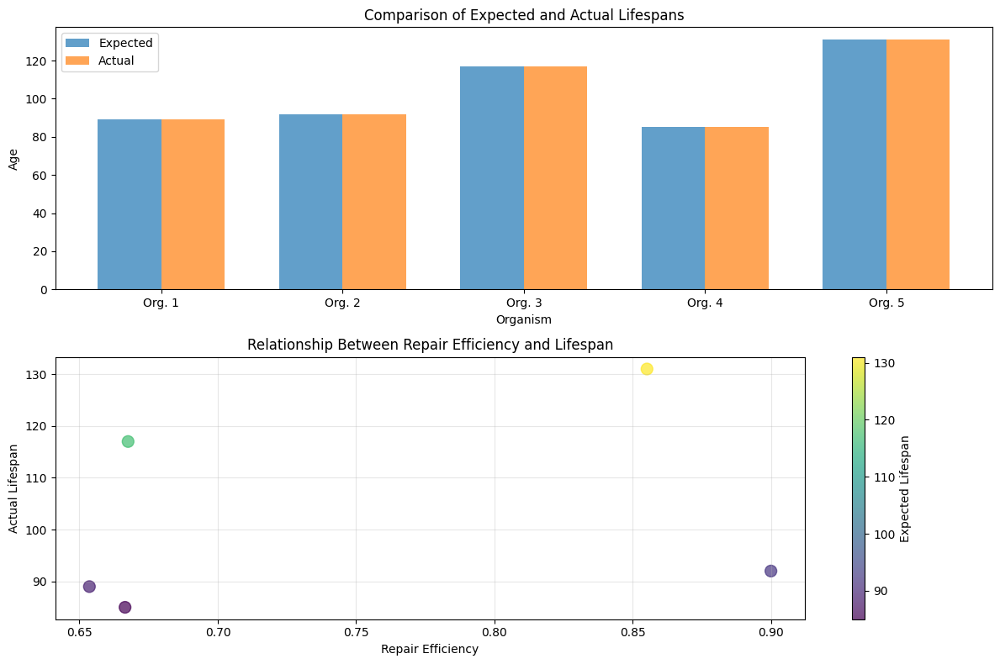


Analyzing organism systems degradation...


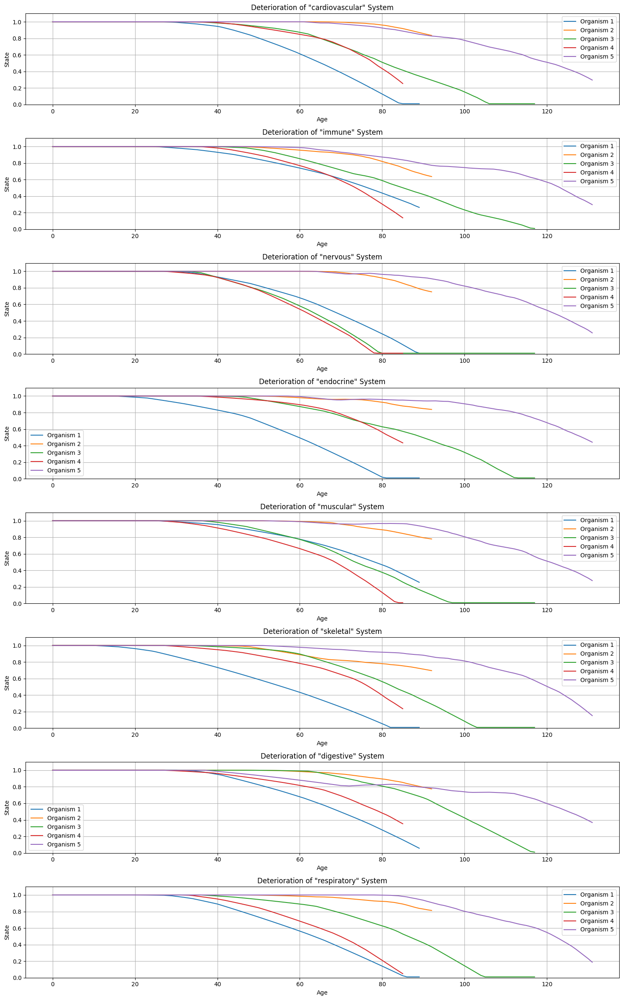


Comparing genome entropy dynamics...


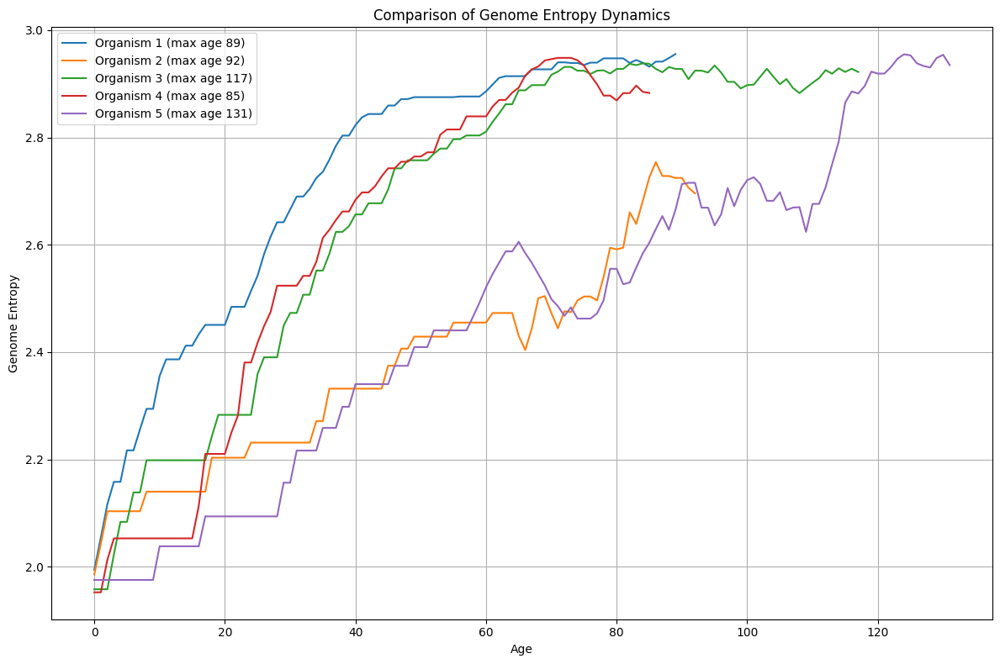


Building homotopic similarity matrix...


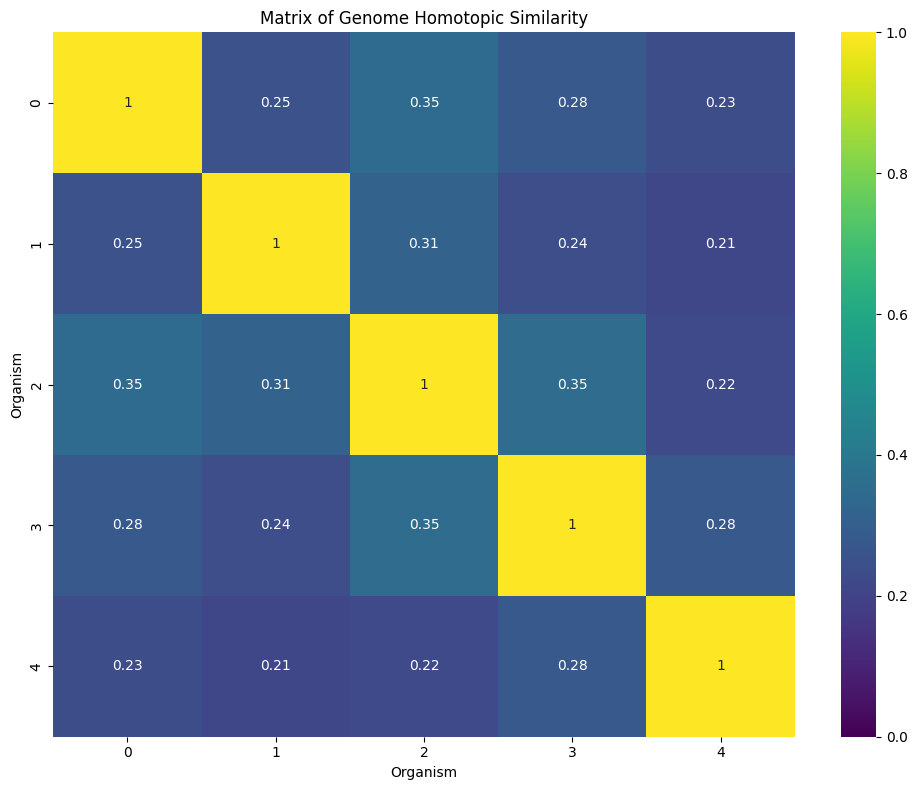


Comparing quantum aging trajectories...


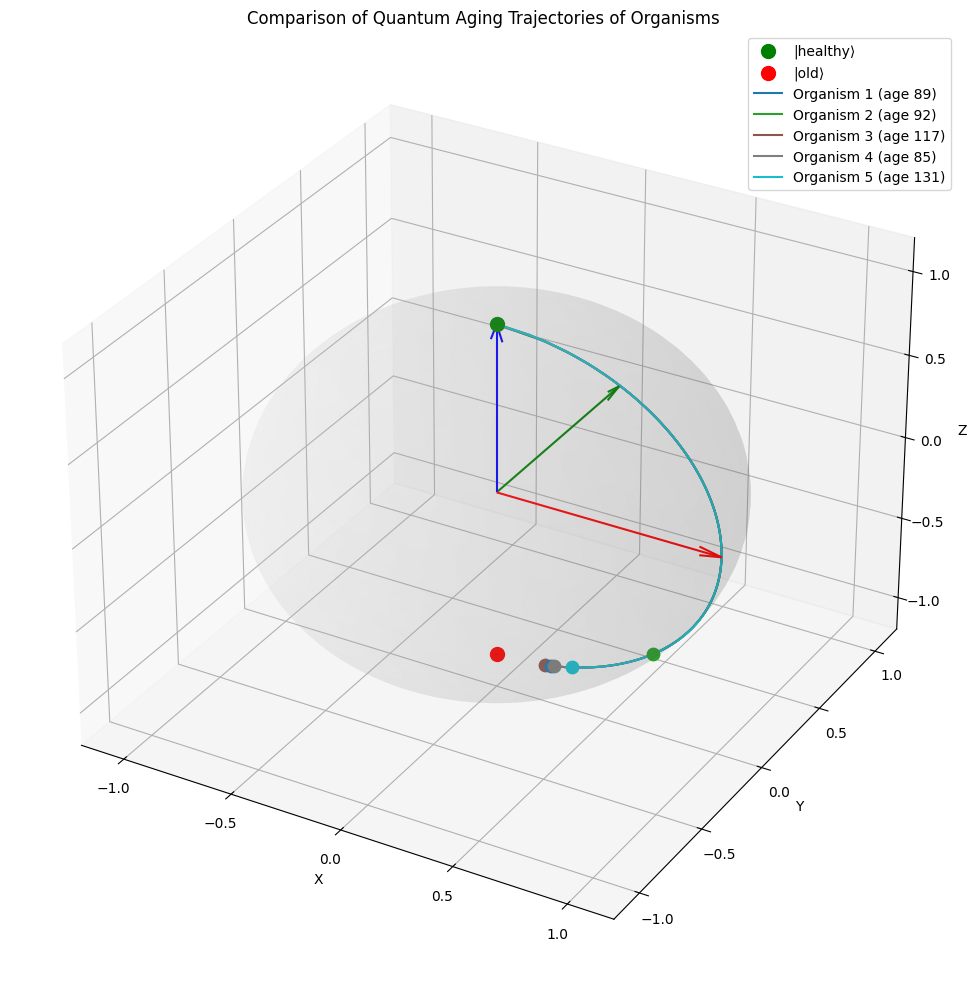

=== Growth and Aging Simulator Demonstration ===

Organism initialized with genome length 200, expected lifespan 100
Organism created. Starting aging simulation...

Age: 10, Vitality: 0.96, Genome Damage: 0.00, Telomere Length: 0.86
Age: 20, Vitality: 0.91, Genome Damage: 0.01, Telomere Length: 0.71
Age: 30, Vitality: 0.87, Genome Damage: 0.00, Telomere Length: 0.56
Age: 40, Vitality: 0.82, Genome Damage: 0.00, Telomere Length: 0.41
Age: 50, Vitality: 0.78, Genome Damage: 0.00, Telomere Length: 0.26
Age: 60, Vitality: 0.73, Genome Damage: 0.01, Telomere Length: 0.11
Age: 70, Vitality: 0.69, Genome Damage: 0.04, Telomere Length: 0.01
Age: 80, Vitality: 0.59, Genome Damage: 0.12, Telomere Length: 0.01
Age: 90, Vitality: 0.47, Genome Damage: 0.22, Telomere Length: 0.01
Organism died of old age at 100
Age: 100, Vitality: 0.33, Genome Damage: 0.39, Telomere Length: 0.01

Simulation completed. The organism lived to age 100.

Visualizing the aging process...


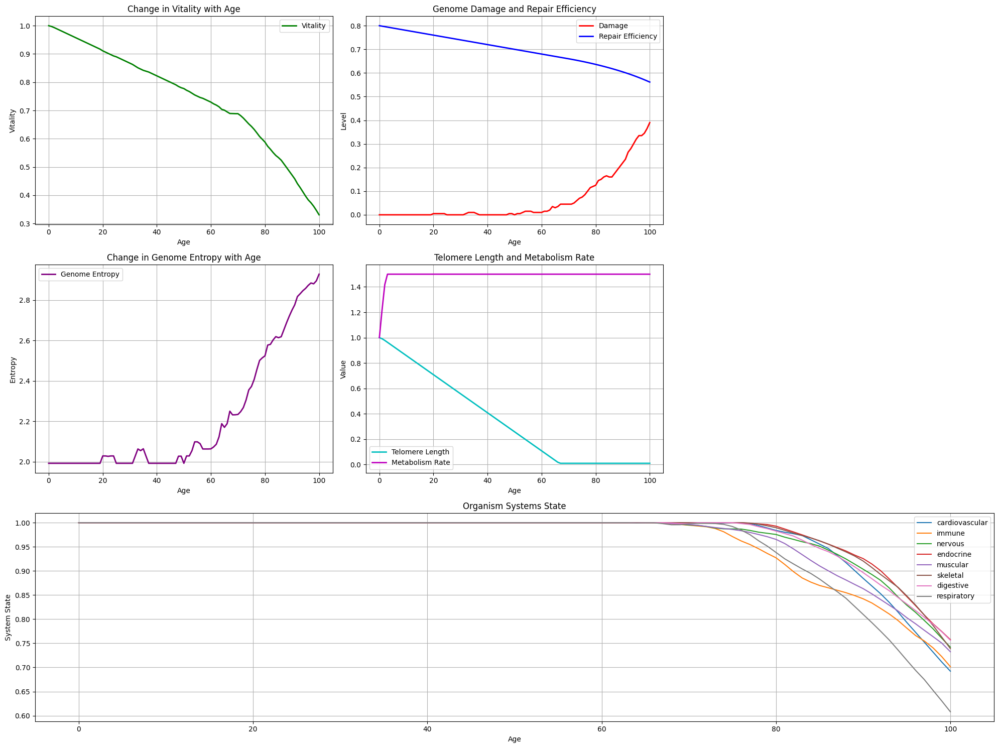


Visualizing genome state...


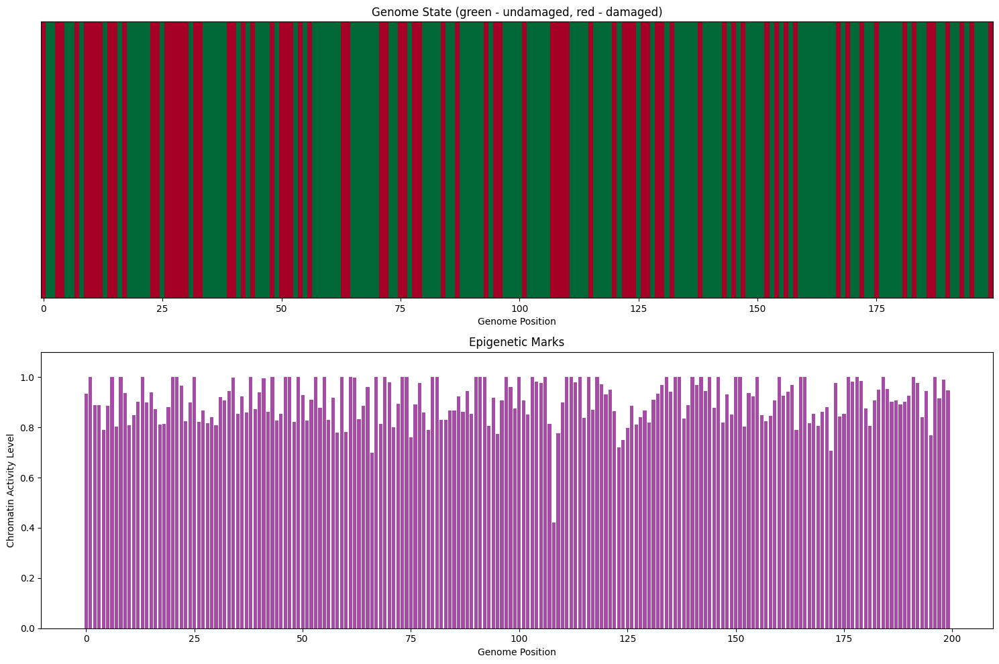


Visualizing quantum state of the organism...


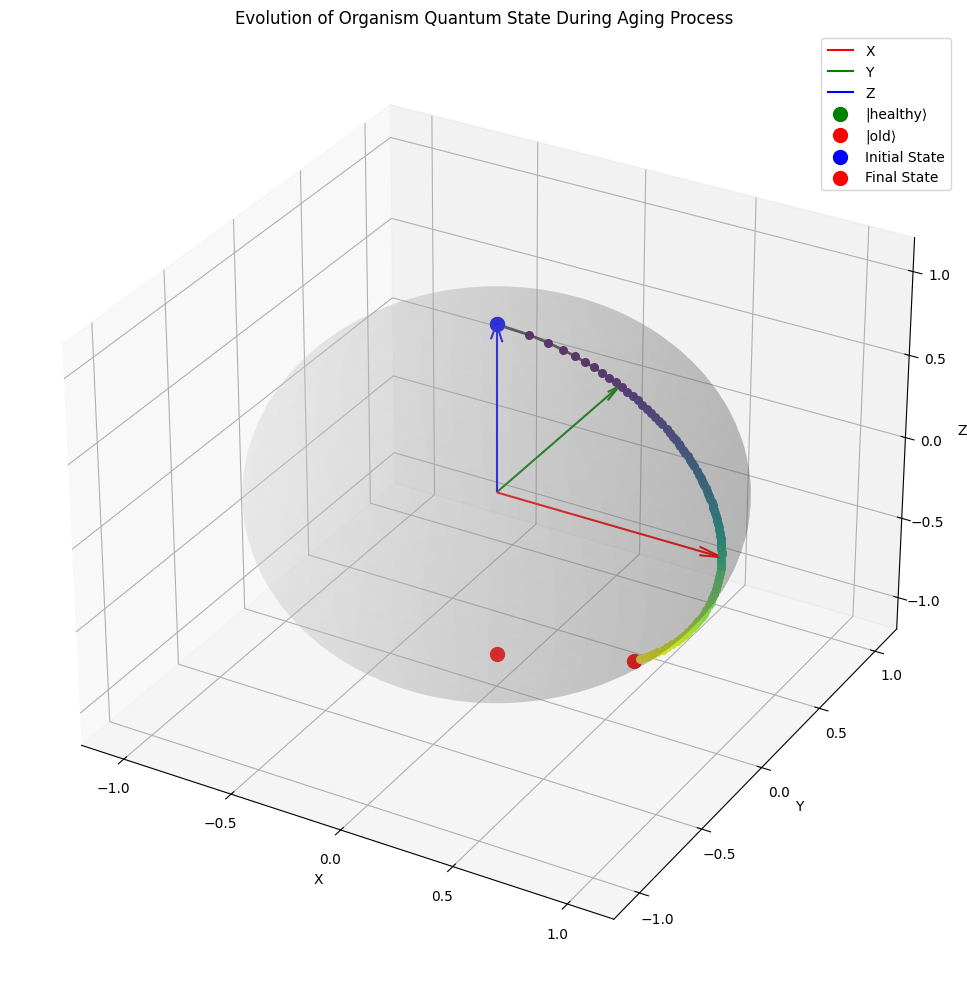


Visualizing damage accumulation patterns...
Organism initialized with genome length 200, expected lifespan 100
Organism died of old age at 100


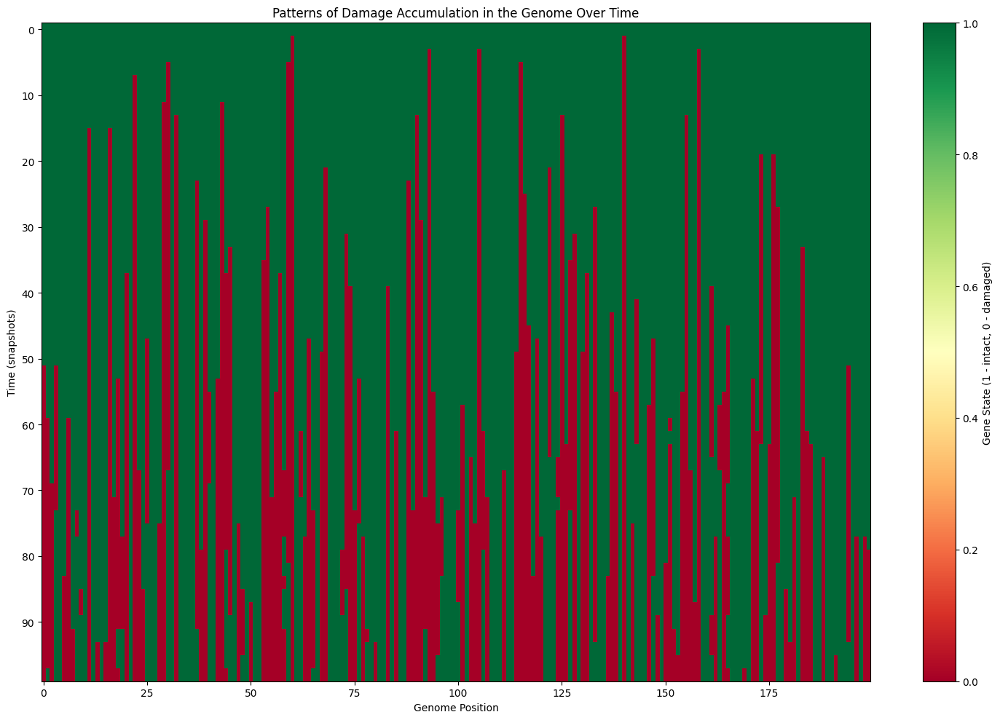


Creating animation of the aging process...
Organism initialized with genome length 200, expected lifespan 100


Animation size has reached 21018668 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Organism died of old age at 100


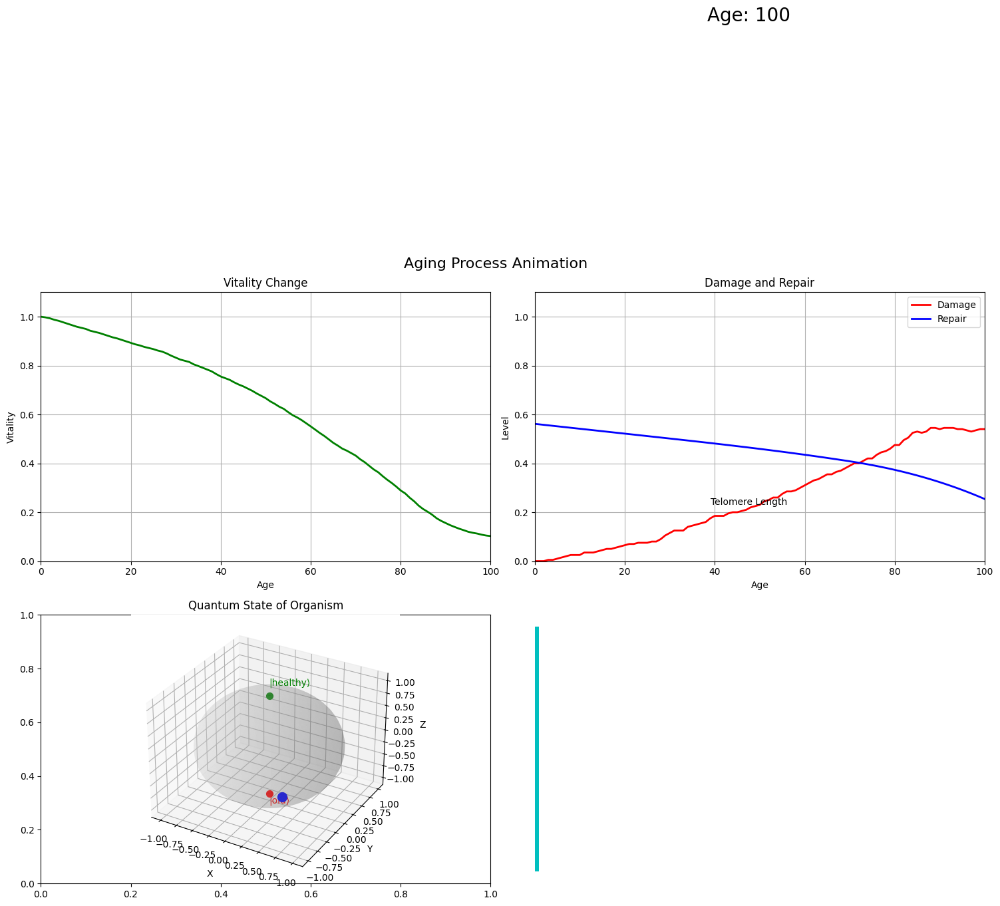

In [9]:
# Run simulation
run_comparative_study()
animation = run_aging_simulation()
animation